# Alexander John Schaller
# Ali El-Guindy


# Financial big data project (FIN-525) : HFT AND NETWORKED MARKETS

*****

# Data preprocessing.

We decided to use polars instead of vaex because vaex has a lot of bugs

In [15]:
#Importing libraries
import numba
import pandas as pd
import polars as pl
import seaborn as sns
import matplotlib.pyplot as plt
import tarfile
import io


In [16]:
#inpecting tar file without unzipping
with tarfile.open('TRTH_CA.tar', 'r') as tar:
    tar.list()

?rwxrwxr-x damien/damien          0 2023-12-06 09:27:47 data/extraction/TRTH/clean/equities/CA/trade_sanitized/ 
?rwxrwxr-x damien/damien          0 2023-12-06 08:40:10 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/ 
?rw-rw-r-- damien/damien       3724 2023-12-06 12:22:01 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-03-05-EMC.ALP-trade.parquet 
?rw-rw-r-- damien/damien       3724 2023-12-06 12:22:01 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-01-29-EMC.ALP-trade.parquet 
?rw-rw-r-- damien/damien       3751 2023-12-06 12:22:01 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-02-10-EMC.ALP-trade.parquet 
?rw-rw-r-- damien/damien       3865 2023-12-06 12:22:01 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-02-26-EMC.ALP-trade.parquet 
?rw-rw-r-- damien/damien       3883 2023-12-06 12:22:01 data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-01-20-EMC.ALP-trade.parquet 
?

In [17]:
#reading tar file
tar_file_path = 'TRTH_CA.tar'

#reading parquet files from tar file and converting to polars dataframe
def read_parquet_from_tar(tar, member):
    f = tar.extractfile(member)
    content = f.read()
    df = pl.read_parquet(io.BytesIO(content))
    stock_name = member.name.split('/')[-2]
    df = df.with_columns([pl.lit(stock_name).alias('stock_id')])
    return df


with tarfile.open(tar_file_path, 'r') as tar:
    for i, member in enumerate(tar.getmembers()):
        if member.isfile() and member.name.endswith('.parquet'):
            df = read_parquet_from_tar(tar, member)
            print(f"Schema for {member.name}: {df.schema}")
            if i >= 5:  # Check the schema of the first few files
                break





Schema for data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-03-05-EMC.ALP-trade.parquet: OrderedDict([('index', Datetime(time_unit='us', time_zone='America/New_York')), ('trade.price', Float64), ('trade.volume', Int32), ('trade.stringflag', Utf8), ('trade.rawflag', Utf8), ('stock_id', Utf8)])
Schema for data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-01-29-EMC.ALP-trade.parquet: OrderedDict([('index', Datetime(time_unit='us', time_zone='America/New_York')), ('trade.price', Float64), ('trade.volume', Int32), ('trade.stringflag', Utf8), ('trade.rawflag', Utf8), ('stock_id', Utf8)])
Schema for data/extraction/TRTH/clean/equities/CA/trade_sanitized/EMC.ALP/2010-02-10-EMC.ALP-trade.parquet: OrderedDict([('index', Datetime(time_unit='us', time_zone='America/New_York')), ('trade.price', Float64), ('trade.volume', Int32), ('trade.stringflag', Utf8), ('trade.rawflag', Utf8), ('stock_id', Utf8)])
Schema for data/extraction/TRTH/clean/equities/CA/trade_sanit

In [18]:
# Concatenate all the DataFrames into a single DataFrame using a dataframes list.
dataframes = []
with tarfile.open(tar_file_path, 'r') as tar:
    for member in tar.getmembers():
        if member.isfile() and member.name.endswith('.parquet'):
            df = read_parquet_from_tar(tar, member)
            if df.width > 0:  # Add a check to ensure DataFrame is not empty
                dataframes.append(df)

try:
    combined_df = pl.concat(dataframes)
    print(combined_df)
except Exception as e:
    print(f"Concatenation failed: {e}")


Concatenation failed: cannot extend/append Int32 with Float64


In [19]:
# Final dataframe with all the 3 months data
#Opened in polars

tar_file_path = 'TRTH_CA.tar'

def read_parquet_from_tar(tar, member):
    f = tar.extractfile(member)
    content = f.read()
    df = pl.read_parquet(io.BytesIO(content))
    stock_name = member.name.split('/')[-2]
    
    # Add stock_id column
    df = df.with_columns([pl.lit(stock_name).alias('stock_id')])

    # Cast numeric columns to Float64
    for col in df.columns:
        if df[col].dtype == pl.Int32:
            df = df.with_columns([df[col].cast(pl.Float64).alias(col)])

    return df

dataframes = []
with tarfile.open(tar_file_path, 'r') as tar:
    for member in tar.getmembers():
        if member.isfile() and member.name.endswith('.parquet'):
            df = read_parquet_from_tar(tar, member)
            if df.width > 0:
                dataframes.append(df)

try:
    combined_df = pl.concat(dataframes)
    print(combined_df)
except Exception as e:
    print(f"Concatenation failed: {e}")


shape: (23_713_129, 6)
┌───────────────────┬─────────────┬──────────────┬──────────────────┬───────────────────┬──────────┐
│ index             ┆ trade.price ┆ trade.volume ┆ trade.stringflag ┆ trade.rawflag     ┆ stock_id │
│ ---               ┆ ---         ┆ ---          ┆ ---              ┆ ---               ┆ ---      │
│ datetime[μs,      ┆ f64         ┆ f64          ┆ str              ┆ str               ┆ str      │
│ America/New_York] ┆             ┆              ┆                  ┆                   ┆          │
╞═══════════════════╪═════════════╪══════════════╪══════════════════╪═══════════════════╪══════════╡
│ 2010-03-05        ┆ 0.18        ┆ 500.0        ┆ uncategorized    ┆ 001;079           ┆ EMC.ALP  │
│ 12:10:20.604 EST  ┆             ┆              ┆                  ┆                   ┆          │
│ 2010-01-29        ┆ 0.175       ┆ 2000.0       ┆ uncategorized    ┆ 019;099           ┆ EMC.ALP  │
│ 11:12:36.074 EST  ┆             ┆              ┆                  

In [20]:
#Using polars : create two seperate columns from trade.rawflag where str[2:] and str[3:] corresponds to seller_id and buyer_id respectively
def get_seller_id(rawflag):
    # Adjust the slicing as per your data format
    return rawflag[:3]  # Assuming seller_id is in the first two characters

def get_buyer_id(rawflag):
    # Adjust the slicing as per your data format
    return rawflag[4:7]  # Assuming buyer_id starts from the 4th character and is two characters long

# Apply the functions to the 'trade.rawflag' column in combined_df to create two new columns one for seller_id and one for buyer_id
df = combined_df.with_columns([
    combined_df['trade.rawflag'].apply(get_seller_id).alias('seller_id'),
    combined_df['trade.rawflag'].apply(get_buyer_id).alias('buyer_id')
])




/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/3058090729.py:12: DeprecationWarning: `apply` is deprecated. It has been renamed to `map_elements`.
  combined_df['trade.rawflag'].apply(get_seller_id).alias('seller_id'),
/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/3058090729.py:13: DeprecationWarning: `apply` is deprecated. It has been renamed to `map_elements`.
  combined_df['trade.rawflag'].apply(get_buyer_id).alias('buyer_id')


In [21]:

# Since the column name has special characters, use backticks to avoid errors.
df = df.with_columns(pl.col("index").dt.month().alias("month"))

# Get the unique months from the 'month' column
unique_months = df.select("month").unique().sort("month")["month"].to_list()

# Create a list of DataFrames, one for each month
df_monthly_list = [df.filter(pl.col("month") == month).drop("month") for month in unique_months]




# Analysis

In [22]:
df_final_list = []  # This list will store the final DataFrames for each month

for monthly_df in df_monthly_list:
    # Group by and aggregate for the monthly data
    stock_counts = monthly_df.groupby('stock_id').agg([
        pl.count().alias('count')
    ])

    # Filter aggregated results for stocks with 100 or more trades
    filtered_stocks = stock_counts.filter(pl.col('count') > 100)

    # Filter the monthly data using the filtered stocks
    df_filtered = monthly_df.join(filtered_stocks.select('stock_id'), on='stock_id', how='inner')

    # Compute total trades per stock
    trades_per_stock = df_filtered.groupby('stock_id').agg([
        pl.count().alias('total_trades')
    ])

    # Compute total transactions per pair
    transactions_per_pair = df_filtered.groupby(['stock_id', 'seller_id', 'buyer_id']).agg([
        pl.count().alias('total_transactions')
    ])

    # Compute total transactions per buyer
    transactions_per_buyer = df_filtered.groupby(['stock_id', 'buyer_id']).agg([
        pl.count().alias('total_transactions')
    ])

    # Compute total transactions per seller
    transactions_per_seller = df_filtered.groupby(['stock_id', 'seller_id']).agg([
        pl.count().alias('total_transactions')
    ])

    # Combine all the dataframes with joins
    df_pair_with_total_trades = transactions_per_pair.join(
        trades_per_stock,
        on='stock_id',
        how='left'
    )

    df_with_buyer_totals = df_pair_with_total_trades.join(
        transactions_per_buyer.rename({'total_transactions': 'total_buyer_transactions'}),
        on=['stock_id', 'buyer_id'],
        how='left'
    )

    df_final = df_with_buyer_totals.join(
        transactions_per_seller.rename({'total_transactions': 'total_seller_transactions'}),
        on=['stock_id', 'seller_id'],
        how='left'
    )

    # Append the final DataFrame for the month to the list
    df_final_list.append(df_final)

# df_final_list now contains a DataFrame for each month


/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/2281249905.py:5: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  stock_counts = monthly_df.groupby('stock_id').agg([
/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/2281249905.py:16: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  trades_per_stock = df_filtered.groupby('stock_id').agg([
/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/2281249905.py:21: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  transactions_per_pair = df_filtered.groupby(['stock_id', 'seller_id', 'buyer_id']).agg([
/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/2281249905.py:26: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  transactions_per_buyer = df_filtered.groupby(['stock_id', 'buyer_id']).agg([
/var/folders/18/5mg94qls17908xtk_njkwfnr0000gn/T/ipykernel_25221/2

# Test statistic for over/under expression

Let us define these variables : 
* total transactions : $N^{AB} _i$
* total trades : $N^{i}$
* total_buyer_transactions : $N^{A} _i$
* total_seller_transactions : $N^{B} _i$
* We wish to compute this as a proxy for the p_value :
$p_1(N^i_{A,B}) = 1 - \sum_{X=0}^{N^i_{A,B} - 1} H(X | N^i, N^i_A, N^i_B)$, where H is the hypergeometric distribution

In [23]:
from scipy.stats import hypergeom
def calculate_hypergeometric_p_value(N_AB, N_A, N_B, N_i):
    # The probability of observing a number of transactions less than N_AB
    # H is the hypergeometric distribution
    # X is the random variable representing the number of successes in n draws
    # M is the population size, n is the number of successes in population, N is the number of draws
    p_value = 1 - hypergeom.cdf(N_AB - 1, N_i, N_A, N_B)
    return p_value

In [24]:
def calculate_hypergeometric_p_value(N_AB, N_A, N_B, N_i):
    # Calculate the hypergeometric p-value
    p_value = 1 - hypergeom.cdf(N_AB - 1, N_i, N_A, N_B)
    return p_value

df_final_pval_list = []  # List to store the final DataFrames with p-values

for df_final in df_final_list:
    # Convert the columns to lists
    total_transactions_list = df_final['total_transactions'].to_list()
    total_trades_list = df_final['total_trades'].to_list()
    total_buyer_transactions_list = df_final['total_buyer_transactions'].to_list()
    total_seller_transactions_list = df_final['total_seller_transactions'].to_list()

    # Calculate the p-values
    p_values = [
        calculate_hypergeometric_p_value(N_AB, N_A, N_B, N_i)
        for N_AB, N_A, N_B, N_i in zip(
            total_transactions_list,
            total_buyer_transactions_list,
            total_seller_transactions_list,
            total_trades_list
        )
    ]

    # Add the p_values as a new column to the DataFrame
    df_final_pval = df_final.with_columns(pl.Series(p_values).alias("p_value"))

    # Append the final DataFrame with p-values to the list
    df_final_pval_list.append(df_final_pval)

# df_final_pval_list now contains a DataFrame with p-values for each month


* If p_value is sufficiently low (fix a significance level $\alpha$) -> overexpressed
* Let's fix $\alpha = 5\%$

In [25]:
df_categorized_list = []
df_overexpressed_list = []  # List to store DataFrames where p_value < 0.05
df_underexpressed_list = []  # List to store DataFrames where p_value >= 0.05

for month, df_final_pval in enumerate(df_final_pval_list):
    # Create two dataframes, one for p_value < 0.05 (overexpressed) and one for p_value >= 0.05 (underexpressed)
    df_categorized = df_final_pval.with_columns(
        Expression = pl.when(pl.col("p_value") < 0.05).then(pl.lit("Overexpressed")).otherwise(pl.lit("Underexpressed"))
    )

    # Filter to create a DataFrame for overexpressed (p_value < 0.05)
    df_overexpressed = df_final_pval.filter(pl.col('p_value') < 0.05)

    # Filter to create a DataFrame for underexpressed (p_value >= 0.05)
    df_underexpressed = df_final_pval.filter(pl.col('p_value') >= 0.05)

    # Append the results to the respective lists
    df_categorized_list.append(df_categorized)
    df_overexpressed_list.append(df_overexpressed)
    df_underexpressed_list.append(df_underexpressed)

# Now, df_overexpressed_list contains the overexpressed DataFrames for each month
# And, df_underexpressed_list contains the underexpressed DataFrames for each month


# Determining the most liquid stocks

In [26]:
concat = pl.concat(df_categorized_list, how="align")

most_liquid = concat.select(['stock_id','total_trades']).unique().sort(by="total_trades", descending=True).head(20)
display(most_liquid)
selected_stocks = most_liquid.head(4)['stock_id'].to_list()
print(selected_stocks)

stock_id,total_trades
str,u32
"""ABX.TO""",180560
"""SU.TO""",170765
"""ABX.TO""",163181
"""G.TO""",155733
"""HNU.ALP""",139739
"""G.TO""",133112
"""SU.TO""",130368
"""SU.ALP""",123437
"""RY.TO""",114746


['ABX.TO', 'SU.TO', 'ABX.TO', 'G.TO']


# Doing network analysis for selected stock : Doing it for the most 4 liquid stocks and could be adjusted.
* ['ABX.TO', 'SU.TO', 'ABX.TO', 'G.TO']

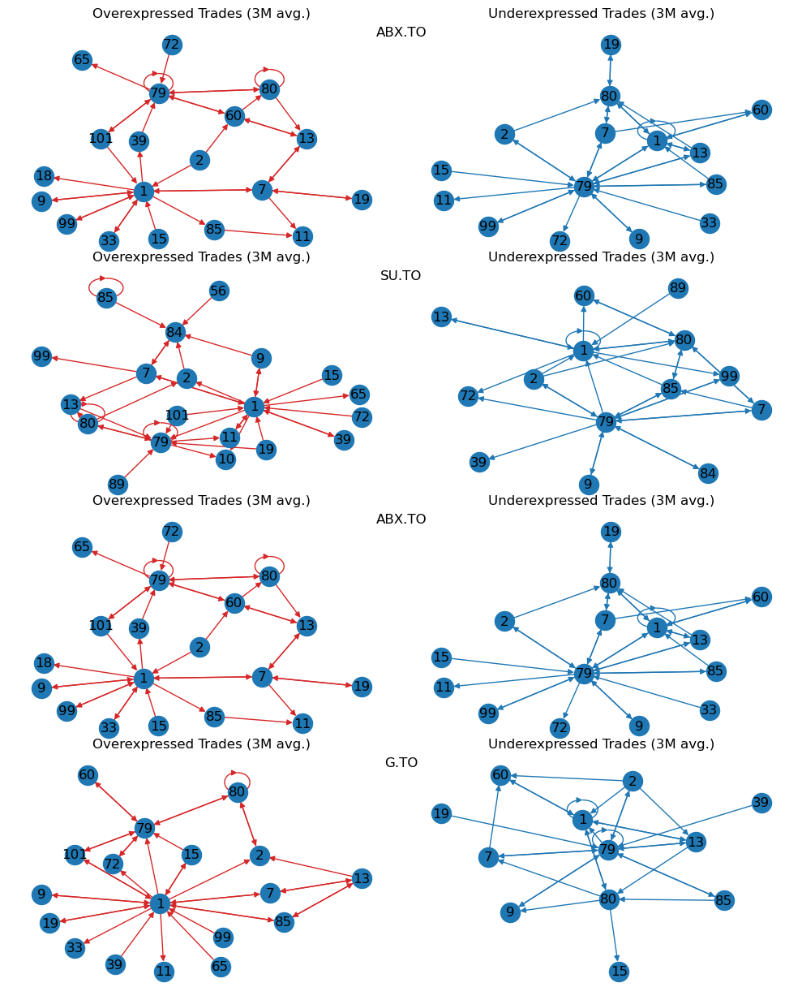

In [27]:
import networkx as nx

top_num = 150
sort_by = 'total_transactions'

fig = plt.figure(figsize=(10, 3*len(selected_stocks)))

subfigs = fig.subfigures(len(selected_stocks), 1)

for selected_stock, subfig in zip(selected_stocks, subfigs):

    subfig.suptitle(selected_stock)
    axs = subfig.subplots(1,2)

    selected_stock_df = concat.filter(pl.col('stock_id') == selected_stock).sort(by=sort_by, descending=True).head(top_num).drop("p_value")
    selected_stock_df = selected_stock_df.group_by(["stock_id","seller_id","buyer_id"]).agg(
        pl.col("total_transactions").sum(),
        pl.col("total_trades").sum(),
        pl.col("total_buyer_transactions").sum(),
        pl.col("total_seller_transactions").sum(),
        pl.col("Expression").mode()
    ).sort(by=sort_by, descending=True)
    selected_stock_df_over = selected_stock_df.filter(pl.col('Expression') == ["Overexpressed"])
    selected_stock_df_under = selected_stock_df.filter(pl.col('Expression') == ["Underexpressed"])

    f = lambda x: int(x) if x.isnumeric() else -1

    nodes_over = set(map(f, selected_stock_df_over['seller_id'].to_list() + selected_stock_df_over['buyer_id'].to_list()))
    nodes_over.discard(-1)
    nodes_under = set(map(f, selected_stock_df_under['seller_id'].to_list() + selected_stock_df_under['buyer_id'].to_list()))
    nodes_under.discard(-1)


    # Create a new graph
    G_over = nx.DiGraph()
    G_under = nx.DiGraph()

    # Add nodes
    G_over.add_nodes_from(nodes_over)
    G_under.add_nodes_from(nodes_under)

    # Add edges
    for row in selected_stock_df_over.to_numpy():
        if not row[2].isnumeric() or not row[1].isnumeric():
            continue
        G_over.add_edge(int(row[2]), int(row[1]), weight=row[6])

    for row in selected_stock_df_under.to_numpy():
        if not row[2].isnumeric() or not row[1].isnumeric():
            continue
        G_under.add_edge(int(row[2]), int(row[1]), weight=row[6])


    axs[0].set_title("Overexpressed Trades (3M avg.)")
    nx.draw(G_over, with_labels=True, pos=nx.nx_agraph.graphviz_layout(G_over), edge_color='tab:red', ax=axs[0])

    axs[1].set_title("Underexpressed Trades (3M avg.)")
    nx.draw(G_under, with_labels=True, pos=nx.nx_agraph.graphviz_layout(G_under), edge_color='tab:blue', ax=axs[1])

fig.tight_layout()

# save the figure
#fig.savefig('network.png', bbox_inches='tight')




Overexpressed Statistics


,Month,Nodes,Clustering Coeff.,Avg. Degree
Month,,,,
Jan,Jan,72,0.157763,3.180556
Feb,Feb,68,0.179057,3.235294
Mar,Mar,54,0.140291,2.777778


Underexpressed Statistics


,Month,Nodes,Clustering Coeff.,Avg. Degree
Month,,,,
Jan,Jan,79,0.60088,14.21519
Feb,Feb,75,0.522574,13.213333
Mar,Mar,66,0.517002,10.333333


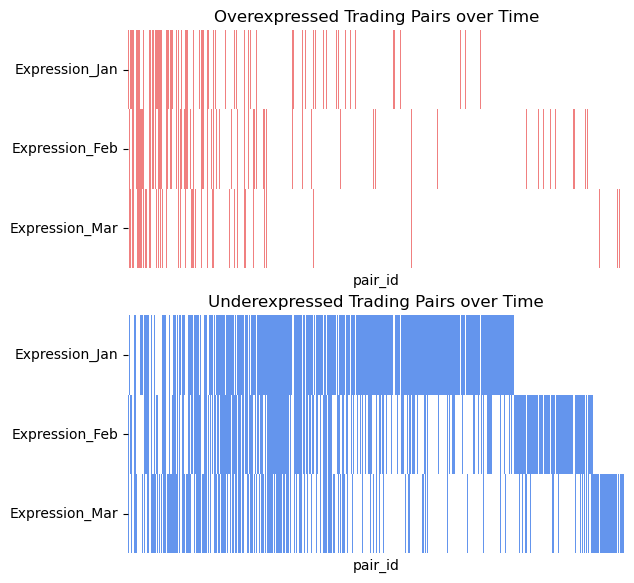

In [28]:
selected_stock = most_liquid.row(3, named=True)['stock_id']

months = {0: "Jan", 1: "Feb", 2:"Mar"}

sort_by = 'total_transactions'
stats_under = pd.DataFrame(columns=["Month", "Nodes", "Clustering Coeff.", "Avg. Degree"])
stats_over = pd.DataFrame(columns=["Month", "Nodes", "Clustering Coeff.", "Avg. Degree"])
stats_under["Month"] = ['Jan', 'Feb', 'Mar']
stats_under.index = stats_under["Month"]

stats_over["Month"] = ['Jan', 'Feb', 'Mar']
stats_over.index = stats_over["Month"]

trade_list = []

# fig, axs = plt.subplots(len(df_categorized_list),2)
axs = [1,2,3]

# fig.set_size_inches(w=10, h=3*len(df_categorized_list))

for idx, (df_categorized, ax) in enumerate(zip(df_categorized_list, axs)):

    selected_stock_df = df_categorized.filter(pl.col('stock_id') == selected_stock).sort(by=sort_by, descending=True).drop("p_value")
    selected_stock_df = selected_stock_df.group_by(["stock_id","seller_id","buyer_id"]).agg(
        pl.col("total_transactions").sum(),
        pl.col("total_trades").sum(),
        pl.col("total_buyer_transactions").sum(),
        pl.col("total_seller_transactions").sum(),
        pl.col("Expression").mode().first()
    ).sort(by=sort_by, descending=True)
    selected_stock_df_over = selected_stock_df.filter(pl.col('Expression') == ["Overexpressed"])
    selected_stock_df_under = selected_stock_df.filter(pl.col('Expression') == ["Underexpressed"])

    trades = selected_stock_df[['seller_id', 'buyer_id','Expression']]
    trades = trades.with_columns(
        pair_id = pl.col('buyer_id')+"-"+pl.col('seller_id')
    )
    trades = trades.drop(['seller_id','buyer_id'])
    trade_list.append(trades)

    f = lambda x: int(x) if x.isnumeric() else -1

    nodes_over = set(map(f, selected_stock_df_over['seller_id'].to_list() + selected_stock_df_over['buyer_id'].to_list()))
    nodes_over.discard(-1)
    nodes_under = set(map(f, selected_stock_df_under['seller_id'].to_list() + selected_stock_df_under['buyer_id'].to_list()))
    nodes_under.discard(-1)


    # Create a new graph
    G_over = nx.DiGraph()
    G_under = nx.DiGraph()

    # Add nodes
    G_over.add_nodes_from(nodes_over)
    G_under.add_nodes_from(nodes_under)

    # Add edges
    for row in selected_stock_df_over.to_numpy():
        if not row[2].isnumeric() or not row[1].isnumeric():
            continue
        G_over.add_edge(int(row[2]), int(row[1]), weight=row[6])

    for row in selected_stock_df_under.to_numpy():
        if not row[2].isnumeric() or not row[1].isnumeric():
            continue
        G_under.add_edge(int(row[2]), int(row[1]), weight=row[6])

    # Compute Statistics
    stats_over["Nodes"][months[idx]] = G_over.number_of_nodes()
    stats_under["Nodes"][months[idx]] = G_under.number_of_nodes()

    stats_over["Clustering Coeff."][months[idx]] = nx.average_clustering(G_over)
    stats_under["Clustering Coeff."][months[idx]] = nx.average_clustering(G_under)

    stats_over["Avg. Degree"][months[idx]] = G_over.number_of_edges()/G_over.number_of_nodes()
    stats_under["Avg. Degree"][months[idx]] = G_under.number_of_edges()/G_under.number_of_nodes()
    
    # # Draw Graph
    # ax[0].set_title(f"Overexpressed Trades ({months[idx]})")
    # nx.draw(G_over, with_labels=True, pos=nx.nx_agraph.graphviz_layout(G_over), edge_color='tab:red', ax=ax[0])

    # ax[1].set_title(f"Underexpressed Trades ({months[idx]})")
    # nx.draw(G_under, with_labels=True, pos=nx.nx_agraph.graphviz_layout(G_under), edge_color='tab:blue', ax=ax[1])

trade_expr = trade_list[0].join(trade_list[1], on="pair_id", how='outer_coalesce', suffix="_Feb")
trade_expr = trade_expr.join(trade_list[2], on="pair_id", how='outer_coalesce', suffix="_Mar")

trade_expr_over = trade_expr.with_columns(
    pl.col("Expression").map_elements(lambda x: 1 if x == "Overexpressed" else 0, skip_nulls=False),
    pl.col("Expression_Feb").map_elements(lambda x: 1 if x == "Overexpressed" else 0, skip_nulls=False),
    pl.col("Expression_Mar").map_elements(lambda x: 1 if x == "Overexpressed" else 0, skip_nulls=False),
).rename({"Expression":"Expression_Jan"}).to_pandas()
trade_expr_over.set_index('pair_id', inplace=True)
trade_expr_under = trade_expr.with_columns(
    pl.col("Expression").map_elements(lambda x: 1 if x == "Underexpressed" else 0, skip_nulls=False),
    pl.col("Expression_Feb").map_elements(lambda x: 1 if x == "Underexpressed" else 0, skip_nulls=False),
    pl.col("Expression_Mar").map_elements(lambda x: 1 if x == "Underexpressed" else 0, skip_nulls=False),
).rename({"Expression":"Expression_Jan"}).to_pandas()
trade_expr_under.set_index('pair_id', inplace=True)

fig.set_size_inches(5,3)

plt.subplot(2,1,1)
plt.title("Overexpressed Trading Pairs over Time")
sns.heatmap(trade_expr_over.transpose(), xticklabels=False, cmap=['w','lightcoral'], cbar=False)

plt.subplot(2,1,2)
plt.title("Underexpressed Trading Pairs over Time")
sns.heatmap(trade_expr_under.transpose(), xticklabels=False, cmap=['w','cornflowerblue'], cbar=False)

plt.subplots_adjust(top=1.2)

print("Overexpressed Statistics")
display(stats_over)
print("Underexpressed Statistics")
display(stats_under)
# fig.tight_layout()



